# Projet 5 - Segmentez des clients d'un site e-commerce

# Essais des différentes approches de modélisation
### Voyons ici 3 méthodes de clustering : KMeans, Classification Hiérarchique et DBSCAN

## 1/ Chargement des librairies 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import random

from sklearn.metrics import *
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster, cut_tree
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from scipy import stats
from datetime import datetime

sns.set_style('darkgrid')

## 2/ Chargement du jeu de données

In [2]:
file = 'C:/Users/raflg/Downloads/OpenClassrooms/Projet 5/'

data_path = file + 'Projet5_final_bis.csv'

data = pd.read_csv(data_path)

date_order = data['order_purchase_timestamp']
data['order_purchase_timestamp'] = pd.to_datetime(date_order)
data

,customer_unique_id,order_purchase_timestamp,recency,number_orders,review_score,payment_value,number_items_ordered,delivery_duration,payment_type_boleto,payment_type_credit_card,payment_type_debit_card,payment_type_voucher,payment_sequential_1.0,payment_sequential_2.0,payment_sequential_3+
0,0000366f3b9a7992bf8c76cfdf3221e2,2018-05-10,111,1,5.0,141.90,1.0,6.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,2018-05-07,114,1,4.0,27.19,1.0,3.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
2,0000f46a3911fa3c0805444483337064,2017-03-10,537,1,3.0,86.22,1.0,26.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
3,0000f6ccb0745a6a4b88665a16c9f078,2017-10-12,321,1,4.0,43.62,1.0,20.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
4,0004aac84e0df4da2b147fca70cf8255,2017-11-14,288,1,5.0,196.89,1.0,13.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90517,fffbf87b7a1a6fa8b03f081c5f51a201,2017-12-27,245,1,5.0,167.32,1.0,19.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
90518,fffea47cd6d3cc0a88bd621562a9d061,2017-12-10,262,1,4.0,84.58,1.0,30.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
90519,ffff371b4d645b6ecea244b27531430a,2017-02-07,568,1,5.0,112.46,1.0,15.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
90520,ffff5962728ec6157033ef9805bacc48,2018-05-02,119,1,5.0,133.69,1.0,12.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0


## 3/ Préparation du jeu de données

In [3]:
cols_to_use = ['recency',
               'number_orders',
               'review_score',
               'payment_value',
               'number_items_ordered',
               'delivery_duration',
               'payment_type_boleto',
               'payment_type_credit_card',
               'payment_type_debit_card',
               'payment_type_voucher',
               'payment_sequential_1.0',
               'payment_sequential_2.0',
               'payment_sequential_3+']

X = data.copy()
X = X[cols_to_use]

# Arrangement des certaines variables
X['review_score'].fillna(np.round(X['review_score'].mean(), 0), inplace=True)

In [4]:
# Standardisation du jeu de données
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

X_scaled = pd.DataFrame(X_scaled, columns=cols_to_use)

## 4/ KMeans

- Nous prendrons 5 variables pour le clustering

Features dans KMeans : ['recency', 'number_orders', 'payment_value']


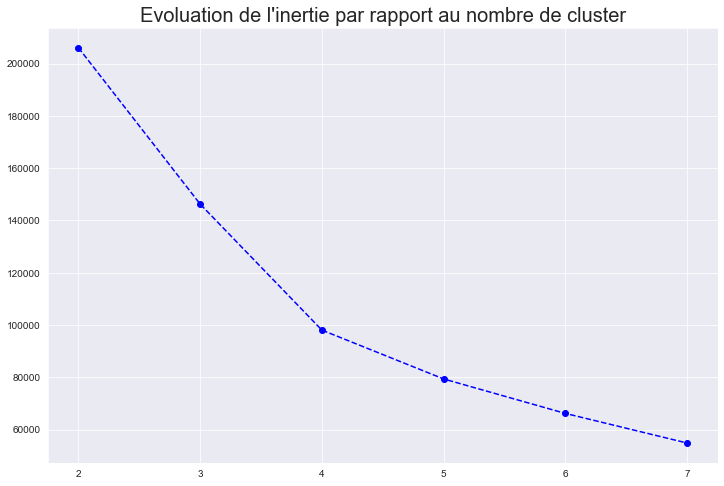

Features dans KMeans : ['recency', 'number_orders', 'payment_value', 'review_score']


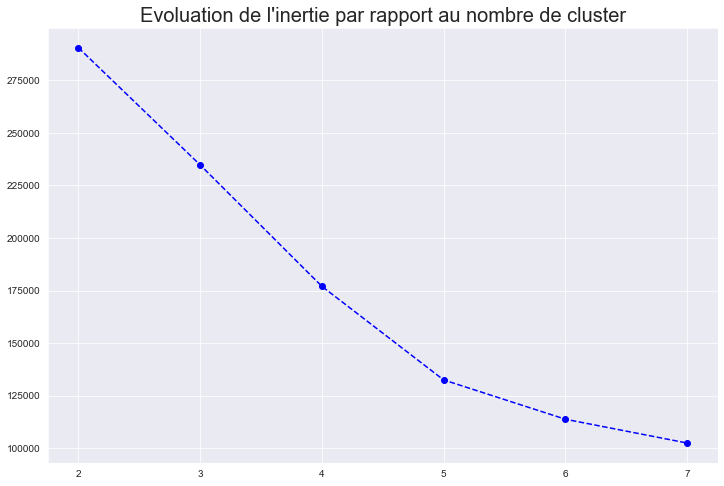

Features dans KMeans : ['recency', 'number_orders', 'payment_value', 'review_score', 'delivery_duration']


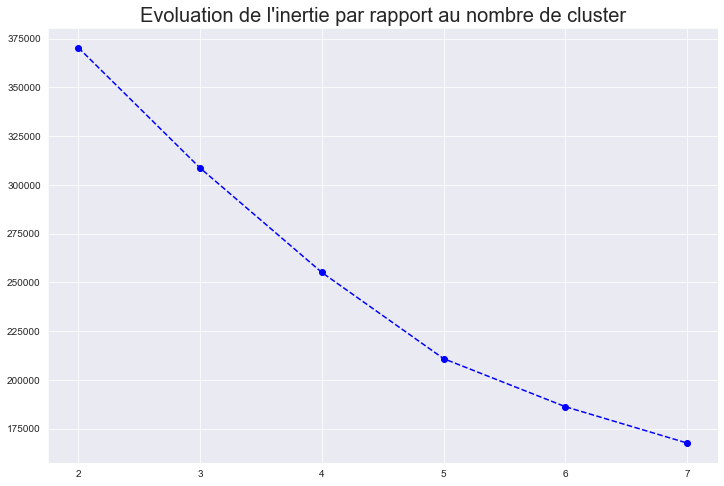

In [5]:
cols_kmeans = ['recency',
               'number_orders',
               'payment_value']

cols_add_kmeans = ['review_score',
                   'delivery_duration',
                   '']

for col in cols_add_kmeans:
    kmeans_per_k = [KMeans(n_clusters=k, init='k-means++', random_state=0).fit(X_scaled[cols_kmeans]) for k in range(2, 8)]
    elbow = [model.inertia_ for model in kmeans_per_k]
    #
    print('Features dans KMeans : {}'.format(cols_kmeans))
    plt.subplots(figsize=(12, 8))
    plt.plot(range(2, 8), elbow, 'bo--')
    plt.title("Evoluation de l'inertie par rapport au nombre de cluster", fontsize=20)
    plt.show()
    cols_kmeans.append(col)

- Intéressons nous maintenant au score de silhouette selon le nombre de clusters

In [6]:
cols_kmeans = ['recency',
               'number_orders',
               'payment_value',
               'review_score',
               'delivery_duration']

for k in range(3, 7):
    km_model = KMeans(n_clusters=k, init='k-means++', random_state=0)
    km_model.fit(X_scaled[cols_kmeans])
    #
    sil_score = silhouette_score(X_scaled[cols_kmeans], km_model.labels_)
    #
    print('Features dans KMeans : {}'.format(cols_kmeans))
    print('Nombre de clusters : {}'.format(k))
    print('Score de silhouette : {}'.format(sil_score))
    print('')

Features dans KMeans : ['recency', 'number_orders', 'payment_value', 'review_score', 'delivery_duration']
Nombre de clusters : 3
Score de silhouette : 0.3554525091453411

Features dans KMeans : ['recency', 'number_orders', 'payment_value', 'review_score', 'delivery_duration']
Nombre de clusters : 4
Score de silhouette : 0.2644541437966453

Features dans KMeans : ['recency', 'number_orders', 'payment_value', 'review_score', 'delivery_duration']
Nombre de clusters : 5
Score de silhouette : 0.2867329916981656

Features dans KMeans : ['recency', 'number_orders', 'payment_value', 'review_score', 'delivery_duration']
Nombre de clusters : 6
Score de silhouette : 0.29632119188577266



- D'un point du vue technique, 3 clusters pour les variables choisies nous donnent de meilleurs résultats

- Voyons donc du point de vue métier le choix des variables ainsi que le nombre de clusters en caractérisant chaque cluster et s'assurer que le clustering est pertinent (bonne séparation des clients)

In [8]:
# Création d'une fonction de calcul
def kmeans_cluster_details(cols, k_clusters):
    '''
    Fonction permettant d'entrainement le modèle de kmeans et ACP
    et retourner différentes visualisations :
    scatter plot ACP, cercle des corrélations et caractérisation des clusters
    @param cols : liste des variables sélectionnées pour le modèle
    @param k_clusters : nombre de clusters
    '''
    X_sub = X_scaled[cols].copy()
    # Entrainement du Kmeans sur les colonnes choisies
    # et nombre k de clusters
    km_model = KMeans(n_clusters=k_clusters, init='k-means++', random_state=0)
    km_model.fit(X_sub)
    #
    # Récupération des labels des clusters
    labels = km_model.labels_
    labels = labels.astype(str)
    #
    if len(cols) <= 3:
        # Jeu de données pour la caractérisation
        full_X = X[cols].copy()
        full_X['Cluster'] = labels
        # Jeu de données pour la corrélation entre cluster
        data_full = X[cols].copy()
        data_full['Cluster'] = labels
        #
        # Visualisation 3D
        fig = px.scatter_3d(X_sub, x=X_sub[X_sub.columns[0]], y=X_sub[X_sub.columns[1]], z=X_sub[X_sub.columns[2]],
                            opacity=0.5, color=labels)
        fig.update_traces(marker_size=2)
        fig.show()
    else:
        # Réalisation de l'ACP
        pca = PCA(n_components=3)
        X_acp = pca.fit_transform(X_sub)
        X_acp = pd.DataFrame(X_acp, columns=['CP{}'.format(i+1)for i in range(len(pca.components_))])
        #
        # Création de jeux de données avec toutes les informations
        # (données standardisées ou non et données de l'ACP)
        # Jeu de données pour la corrélation
        full_X_std = pd.concat([X_sub, X_acp], axis=1)
        # Jeu de données pour la caractérisation
        full_X = pd.concat([X[cols], X_acp], axis=1)
        full_X['Cluster'] = labels
        # Jeu de données pour la corrélation entre cluster
        data_full = X[cols].copy()
        data_full['Cluster'] = labels
        #
        # Calcul de la corrélation des variables (standardisées)
        # avec les composantes principales
        corr_table = pd.DataFrame(index=cols, columns=X_acp.columns)
        for m in corr_table.index:
            for c in corr_table.columns:
                corr, t = stats.pearsonr(full_X_std[m], full_X_std[c])
                corr_table.loc[m, c] = corr
        #
        corr_table = corr_table.astype('float')
        #
        print("Features dans l'ACP : {}".format(cols))
        #
        # Visualisation
        fig, axes = plt.subplots(1, 2, figsize=(20, 10))
        # Visualisation 2D des composantes principales
        # colorées selon le cluster
        sns.scatterplot(ax=axes[0], data=full_X, x='CP1', y='CP2', hue='Cluster')
        # Visualisation du cercle des corrélations
        for i in range(0, corr_table.shape[0]):
            axes[1].arrow(0, 0,
                          corr_table.iloc[i, 0], corr_table.iloc[i, 1],
                          head_width=0.05, length_includes_head=True, color='black')
            #
            plt.text(corr_table.iloc[i, 0] + 0.05,
                     corr_table.iloc[i, 1] + 0.05,
                     cols[i])
        #
        an = np.linspace(0, 2 * np.pi, 100)
        plt.plot(np.cos(an), np.sin(an))
        plt.axvline(x=0, color='black', linestyle='--', linewidth=0.8)
        plt.axhline(y=0, color='black', linestyle='--', linewidth=0.8)
        plt.axis('equal')
        plt.show()
        # Visualisation 3D des composantes principales
        fig = px.scatter_3d(full_X, x=full_X['CP1'], y=full_X['CP2'], z=full_X['CP3'],
                            opacity=0.5, color='Cluster')
        fig.update_traces(marker_size=2)
        fig.show()
    #
    # Caractérisation des clusters
    clusters_ = full_X['Cluster'].unique().tolist()
    recap_cluster = pd.DataFrame(columns=clusters_, index=cols)
    #
    for cluster in clusters_:
        for col in cols:
            recap_cluster.loc[col, cluster] = np.round(full_X.loc[full_X['Cluster'] == cluster, col].mean(), 0)
            recap_cluster.loc[col, 'Global'] = np.round(full_X[col].mean(), 0)
            #
            # Calcul de la valeur test (valeur de représenation)
            mean_gnl = full_X[col].mean()
            mean_cluster = full_X.loc[full_X['Cluster'] == cluster,
                                      col].mean()
            nb_gnl = full_X.shape[0]
            nb_cluster = full_X.loc[full_X['Cluster'] == cluster].shape[0]
            var_gnl = np.var(full_X[col], ddof=1)
            #
            num = mean_cluster - mean_gnl
            first_div = (nb_gnl - nb_cluster) / (nb_gnl - 1)
            second_div = var_gnl/nb_cluster
            den = np.sqrt(first_div * second_div)
            #
            test_value = num / den
            #
            recap_cluster.loc[col, 'Test value Cluster ' + str(int(cluster)+1)] = test_value
    #
    recap_cluster.rename(columns={cl:'Cluster ' + str(int(cl)+1) for clin clusters_}, inplace=True)
    #
    # Caractérisation par cluster
    for cluster in [f'Cluster {str(int(i)+1)}'
                    for i in clusters_]:
        int_cluster = int(cluster.split(' ')[1]) - 1
        nb_cluster = full_X.loc[full_X['Cluster'] == str(int_cluster)].shape[0]
        print(f'Caractérisation du {cluster} ({str(nb_cluster)} clients dans le cluster)')
        cluster_cols = recap_cluster.columns[recap_cluster.columns.str.contains(cluster)].tolist()
        cluster_cols.append('Global')
        #
        df_to_display = recap_cluster[cluster_cols]
        df_to_display = df_to_display.reindex(columns=[cluster, 'Global', f'Test value {cluster}'])
        display(df_to_display.sort_values(by=f'Test value {cluster}', ascending=False))
    #
    # Boxplot des variables par cluster
    full_X['Cluster'].replace({i:f'Cluster {str(int(i)+1)}' for i in full_X['Cluster'].unique()}, inplace=True)
    fig, axes = plt.subplots(1, len(cols), figsize=(20, 10))
    #
    for i, col in enumerate(cols):
        sns.boxplot(ax=axes[i], data=full_X, x='Cluster', y=col, showfliers=False)
    #
    # Heatmap de corrélation pour chaque cluster
    fig_hm, axes_hp = plt.subplots(1, len(clusters_), figsize=(20, 5), sharey=True)
    #
    for i, cluster in enumerate(clusters_):
        sub = data_full[data_full['Cluster'] == cluster].copy()
        sns.heatmap(ax=axes_hp[i], data=sub.corr(), annot=True, cmap='Reds',
                    mask=np.tril(np.ones_like(sub.corr(), dtype=bool)), vmin=-1, vmax=1)
        axes_hp[i].set_title(f'Cluster {str(int(cluster)+1)}')

Features dans l'ACP : ['recency', 'number_orders', 'payment_value', 'review_score', 'delivery_duration']


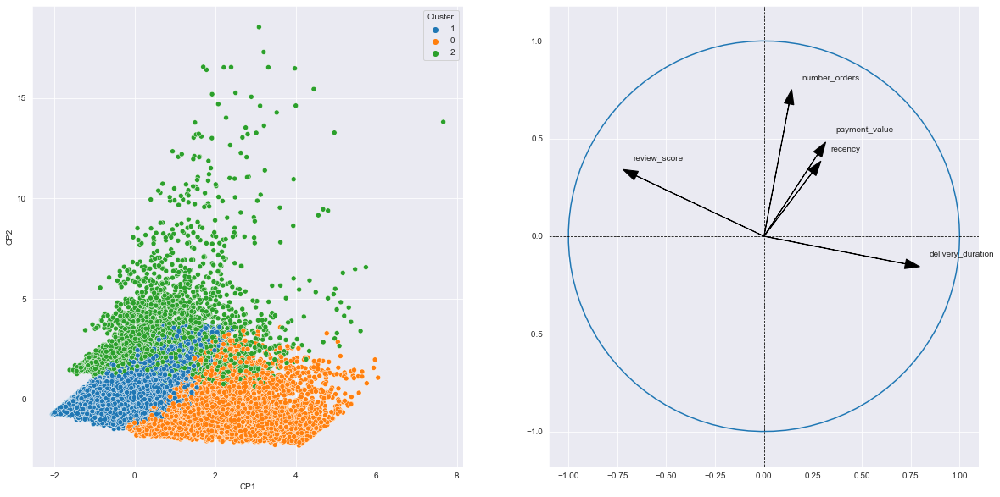

Caractérisation du Cluster 2 (68718 clients dans le cluster)


,Cluster 2,Global,Test value Cluster 2
review_score,5.0,4.0,213.986677
recency,234.0,240.0,-20.707520
payment_value,137.0,147.0,-38.396514
number_orders,1.0,1.0,-110.291068
delivery_duration,10.0,12.0,-131.102761


Caractérisation du Cluster 1 (16771 clients dans le cluster)


,Cluster 1,Global,Test value Cluster 1
delivery_duration,20.0,12.0,145.625409
payment_value,170.0,147.0,23.939856
recency,250.0,240.0,9.765915
number_orders,1.0,1.0,-26.813418
review_score,2.0,4.0,-237.539913


Caractérisation du Cluster 3 (5033 clients dans le cluster)


,Cluster 3,Global,Test value Cluster 3
number_orders,2.0,1.0,251.275931
payment_value,206.0,147.0,31.061958
recency,286.0,240.0,22.084293
review_score,4.0,4.0,3.425798
delivery_duration,12.0,12.0,-2.255432


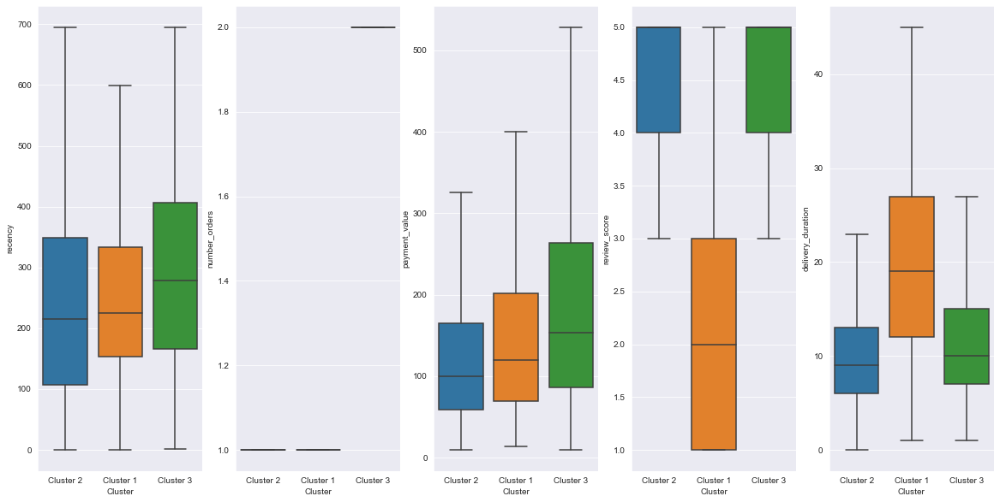

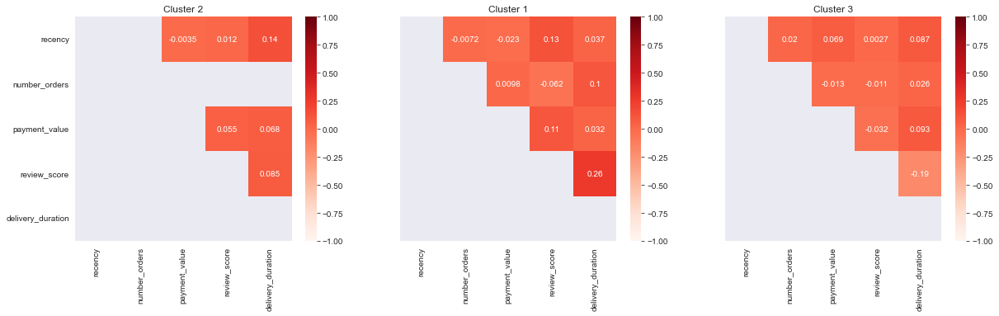

In [13]:
kmeans_cluster_details(['recency',
                        'number_orders',
                        'payment_value',
                        'review_score',
                        'delivery_duration'], 3)

Features dans l'ACP : ['recency', 'number_orders', 'payment_value', 'review_score', 'delivery_duration']


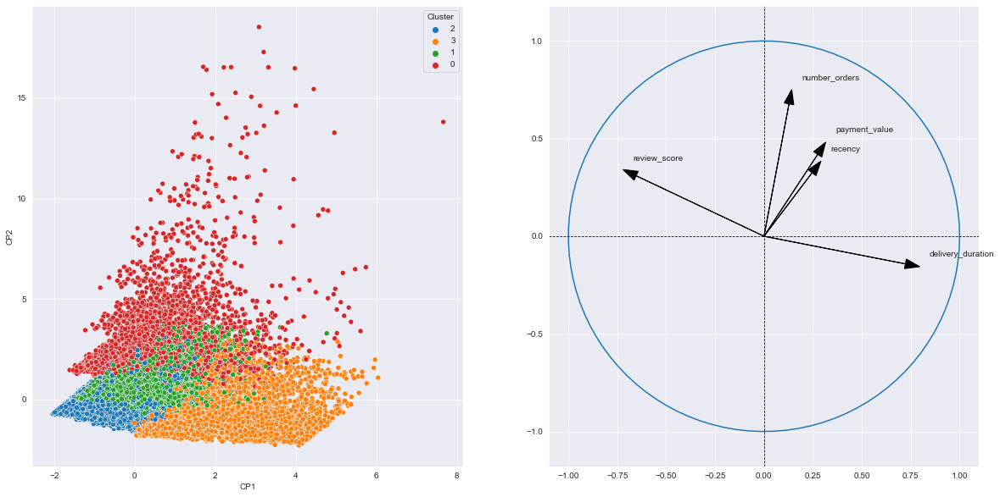

Caractérisation du Cluster 3 (39884 clients dans le cluster)


,Cluster 3,Global,Test value Cluster 3
review_score,5.0,4.0,100.904407
payment_value,136.0,147.0,-20.785957
number_orders,1.0,1.0,-55.135873
delivery_duration,9.0,12.0,-94.581902
recency,121.0,240.0,-207.354712


Caractérisation du Cluster 4 (14048 clients dans le cluster)


,Cluster 4,Global,Test value Cluster 4
delivery_duration,20.0,12.0,135.160567
payment_value,168.0,147.0,19.766886
recency,230.0,240.0,-7.949657
number_orders,1.0,1.0,-23.503617
review_score,2.0,4.0,-241.318585


Caractérisation du Cluster 2 (31561 clients dans le cluster)


,Cluster 2,Global,Test value Cluster 2
recency,387.0,240.0,211.433169
review_score,5.0,4.0,76.522624
delivery_duration,12.0,12.0,-3.040453
payment_value,142.0,147.0,-8.300156
number_orders,1.0,1.0,-45.453375


Caractérisation du Cluster 1 (5029 clients dans le cluster)


,Cluster 1,Global,Test value Cluster 1
number_orders,2.0,1.0,251.214578
payment_value,207.0,147.0,31.072403
recency,286.0,240.0,22.108589
review_score,4.0,4.0,3.563981
delivery_duration,12.0,12.0,-2.333856


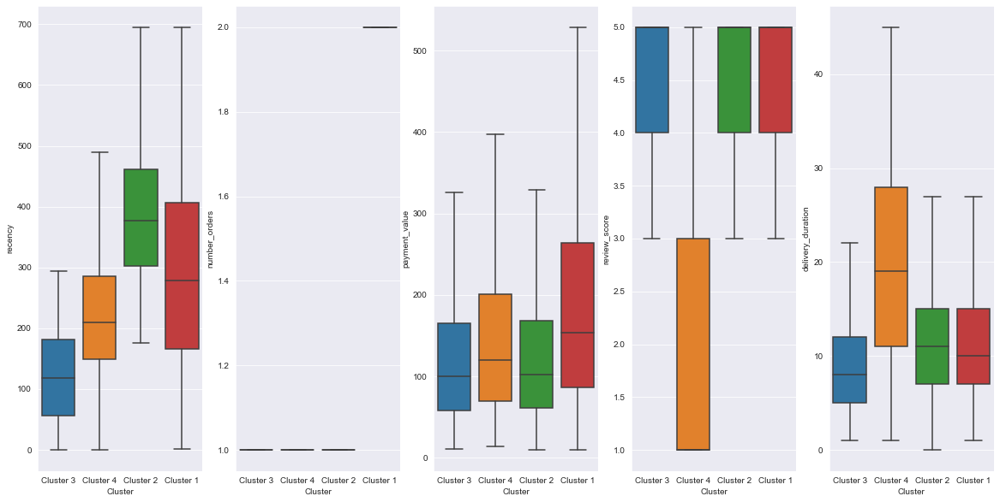

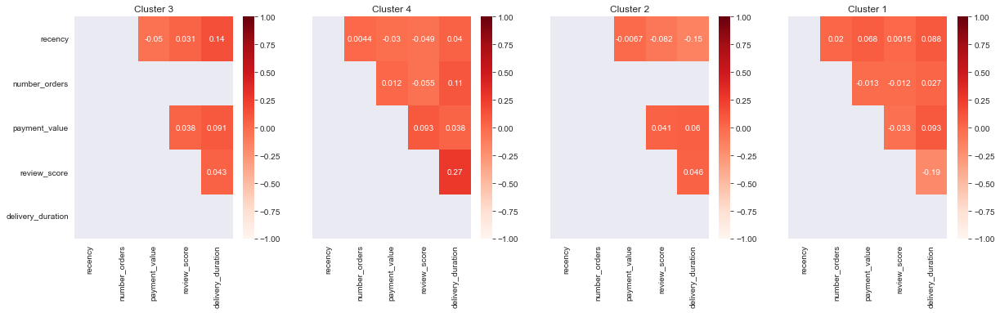

In [14]:
kmeans_cluster_details(['recency',
                        'number_orders',
                        'payment_value',
                        'review_score',
                        'delivery_duration'], 4)

- D'un point de vue métier, 3 clusters avec les variables RFM + review score et le délai de livraison semblent être les paramètres pertinents

## 5/ Classification hiérarchique

- Pour écourter le temps de calcul dans l'obtention du dendrogramme, nous allons procéder avec un échantillon de notre jeu de données

In [15]:
customer_sample = random.sample(data['customer_unique_id'].tolist(), 1000)
data_sample = data[data['customer_unique_id'].isin(customer_sample)].copy()

X_sample = data_sample.copy()
X_sample = X_sample[cols_to_use]

# Arrangement des certaines variables
X_sample['review_score'].fillna(np.round(X_sample['review_score'].mean(), 0), inplace=True)

# Standardisation du jeu de données
scaler = StandardScaler()
X_scaled_sample = scaler.fit_transform(X_sample)

X_scaled_sample = pd.DataFrame(X_scaled_sample, columns=cols_to_use)

In [16]:
# Création d'une fonction de calcul
def ch_cluster_details(cols, k_clusters):
      '''
    Fonction permettant d'entrainement le modèle de CHA et ACP
    et retourner différentes visualisations :
    scatter plot ACP, cercle des corrélations et caractérisation des clusters
    @param cols : liste des variables sélectionnées pour le modèle
    @param k_clusters : nombre de clusters
    '''
    X_sub = X_scaled_sample[cols].copy()
    # Entrainement du Kmeans sur les colonnes choisies
    # et nombre k de clusters
    ch_model = AgglomerativeClustering(n_clusters=k_clusters, affinity='euclidean', linkage='ward')
    ch_model.fit(X_sub)
    #
    # Récupération des labels des clusters
    labels = ch_model.labels_
    labels = labels.astype(str)
    #
    if len(cols) <= 3:
        # Jeu de données pour la caractérisation
        full_X = X_sample[cols].copy()
        full_X['Cluster'] = labels
        # Jeu de données pour la corrélation entre cluster
        data_full = X_sample[cols].copy()
        data_full['Cluster'] = labels
        #
        # Visualisation 3D
        fig = px.scatter_3d(X_sub, x=X_sub[X_sub.columns[0]], y=X_sub[X_sub.columns[1]], z=X_sub[X_sub.columns[2]],
                            opacity=0.5, color=labels)
        fig.update_traces(marker_size=2)
        fig.show()
    else:
        # Réalisation de l'ACP
        pca = PCA(n_components=3)
        X_acp = pca.fit_transform(X_sub)
        X_acp = pd.DataFrame(X_acp, columns=['CP{}'.format(i+1) for i in range(len(pca.components_))])
        #
        # Création de jeux de données avec toutes les informations
        # (données standardisées ou non et données de l'ACP)
        # Jeu de données pour le cercle des corrélations
        full_X_std = pd.concat([X_sub, X_acp], axis=1)
        # Jeu de données pour la caractérisation
        full_X = pd.concat([X_sample[cols].reset_index(drop=True), X_acp], axis=1)
        full_X['Cluster'] = labels
        # Jeu de données pour la corrélation entre cluster
        data_full = X_sample[cols].copy()
        data_full['Cluster'] = labels
        #
        # Calcul de la corrélation des variables (standardisées)
        # avec les composantes principales
        corr_table = pd.DataFrame(index=cols, columns=X_acp.columns)
        for m in corr_table.index:
            for c in corr_table.columns:
                corr, t = stats.pearsonr(full_X_std[m], full_X_std[c])
                corr_table.loc[m, c] = corr
        #
        corr_table = corr_table.astype('float')
        #
        print("Features dans l'ACP : {}".format(cols))
        #
        # Visualisation
        fig, axes = plt.subplots(1, 2, figsize=(20, 10))
        # Visualisation 2D des composantes principales
        # colorées selon le cluster
        sns.scatterplot(ax=axes[0], data=full_X, x='CP1', y='CP2',hue='Cluster')
        # Visualisation du cercle des corrélations
        for i in range(0, corr_table.shape[0]):
            axes[1].arrow(0, 0,
                          corr_table.iloc[i, 0], corr_table.iloc[i, 1],
                          head_width=0.05, length_includes_head=True, color='black')
            #
            plt.text(corr_table.iloc[i, 0] + 0.05,
                     corr_table.iloc[i, 1] + 0.05,
                     cols[i])
        #
        an = np.linspace(0, 2 * np.pi, 100)
        plt.plot(np.cos(an), np.sin(an))
        plt.axvline(x=0, color='black', linestyle='--', linewidth=0.8)
        plt.axhline(y=0, color='black', linestyle='--', linewidth=0.8)
        plt.axis('equal')
        plt.show()
        # Visualisation 3D des composantes principales
        fig = px.scatter_3d(full_X, x=full_X['CP1'], y=full_X['CP2'], z=full_X['CP3'],
                            opacity=0.5, color='Cluster')
        fig.update_traces(marker_size=2)
        fig.show()
    #
    # Caractérisation des clusters
    clusters_ = full_X['Cluster'].unique().tolist()
    recap_cluster = pd.DataFrame(columns=clusters_, index=cols)
    #
    for cluster in clusters_:
        for col in cols:
            recap_cluster.loc[col, cluster] = np.round(full_X.loc[full_X['Cluster'] == cluster, col].mean(), 0)
            recap_cluster.loc[col, 'Global'] = np.round(full_X[col].mean(), 0)
            # Calcul de la valeur test (valeur de représenation)
            mean_gnl = full_X[col].mean()
            mean_cluster = full_X.loc[full_X['Cluster'] == cluster, col].mean()
            nb_gnl = full_X.shape[0]
            nb_cluster = full_X.loc[full_X['Cluster'] == cluster].shape[0]
            var_gnl = np.var(full_X[col], ddof=1)
            #
            num = mean_cluster - mean_gnl
            first_div = (nb_gnl - nb_cluster) / (nb_gnl - 1)
            second_div = var_gnl/nb_cluster
            den = np.sqrt(first_div*second_div)
            #
            test_value = num / den
            #
            recap_cluster.loc[col, 'Test value Cluster ' + str(int(cluster)+1)] = test_value
    #
    recap_cluster.rename(columns={cl:'Cluster ' + str(int(cl)+1) for cl in clusters_}, inplace=True)
    #
    for cluster in [f'Cluster {str(int(i)+1)}' for i in clusters_]:
        int_cluster = int(cluster.split(' ')[1]) - 1
        nb_cluster = full_X.loc[full_X['Cluster'] == str(int_cluster)].shape[0]
        print(f'Caractérisation du {cluster} ({str(nb_cluster)} clients dans le cluster)')
        cluster_cols = recap_cluster.columns[recap_cluster.columns.str.contains(cluster)].tolist()
        cluster_cols.append('Global')
        # 
        df_to_display = recap_cluster[cluster_cols]
        df_to_display = df_to_display.reindex(columns=[cluster, 'Global', f'Test value {cluster}'])
        display(df_to_display.sort_values(by=f'Test value {cluster}', ascending=False))
    #    
    # Boxplot des variables par cluster
    full_X['Cluster'].replace({i:f'Cluster {str(int(i)+1)}' for i in full_X['Cluster'].unique()}, inplace=True)
    fig, axes = plt.subplots(1, len(cols), figsize=(20, 10))
    #
    for i, col in enumerate(cols):
        sns.boxplot(ax=axes[i], data=full_X, x='Cluster', y=col, showfliers=False)
    #   
    # Heatmap de corrélation pour chaque cluster
    fig_hm, axes_hp = plt.subplots(1, len(clusters_), figsize=(20, 5), sharey=True)
    #
    for i, cluster in enumerate(clusters_):
        sub = data_full[data_full['Cluster']==cluster].copy()
        sns.heatmap(ax=axes_hp[i], data=sub.corr(), annot=True, cmap='Reds', 
                    mask=np.tril(np.ones_like(sub.corr(), dtype=bool)), vmin=-1, vmax=1)
        axes_hp[i].set_title(f'Cluster {str(int(cluster)+1)}')

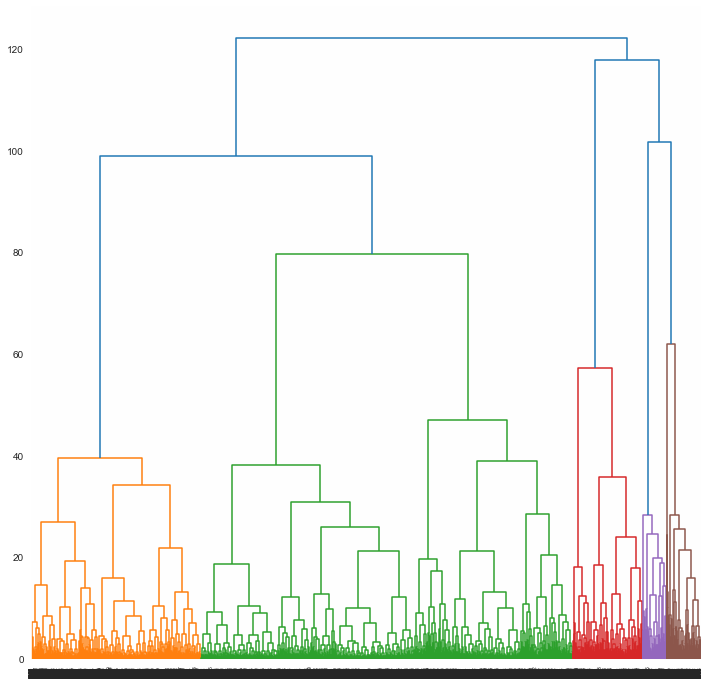

In [26]:
rfm_cols = ['recency',
            'number_orders',
            'payment_value',
            'review_score',
            'delivery_duration']

hac_dend = linkage(X_scaled_sample[rfm_cols], method='ward', metric='euclidean')
plt.figure(figsize=(12, 12))
dendrogram(hac_dend)
plt.show()

In [27]:
model = AgglomerativeClustering(n_clusters=5, affinity='euclidean', linkage='ward')
model.fit(X_scaled_sample[rfm_cols])
labels_ch = model.labels_

In [28]:
silhouette_score(X_scaled_sample[rfm_cols], labels_ch)

0.24106420548884944

Features dans l'ACP : ['recency', 'number_orders', 'payment_value', 'review_score', 'delivery_duration']


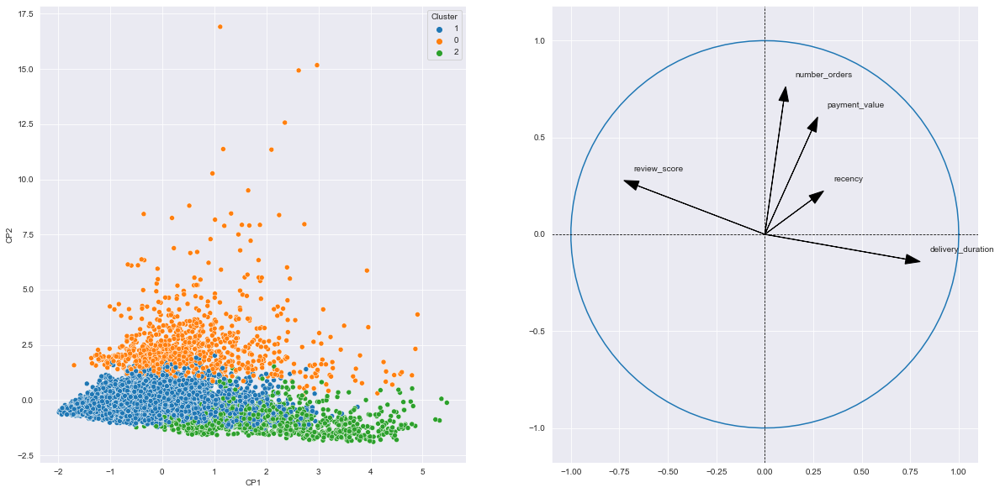

Caractérisation du Cluster 2 (8098 clients dans le cluster)


,Cluster 2,Global,Test value Cluster 2
review_score,5.0,4.0,62.770697
recency,239.0,243.0,-4.705849
delivery_duration,11.0,12.0,-21.733952
payment_value,121.0,145.0,-35.189694
number_orders,1.0,1.0,-42.307968


Caractérisation du Cluster 1 (866 clients dans le cluster)


,Cluster 1,Global,Test value Cluster 1
number_orders,2.0,1.0,66.590165
payment_value,372.0,145.0,51.287821
recency,259.0,243.0,3.272926
delivery_duration,12.0,12.0,0.315287
review_score,4.0,4.0,-0.708339


Caractérisation du Cluster 3 (1036 clients dans le cluster)


,Cluster 3,Global,Test value Cluster 3
delivery_duration,18.0,12.0,27.698964
recency,257.0,243.0,3.039790
payment_value,137.0,145.0,-2.015120
number_orders,1.0,1.0,-6.970557
review_score,1.0,4.0,-80.185148


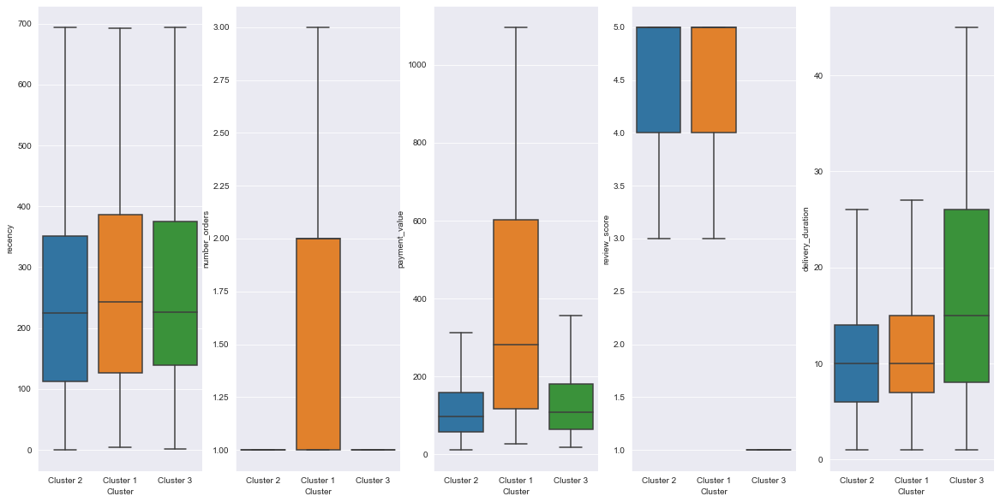

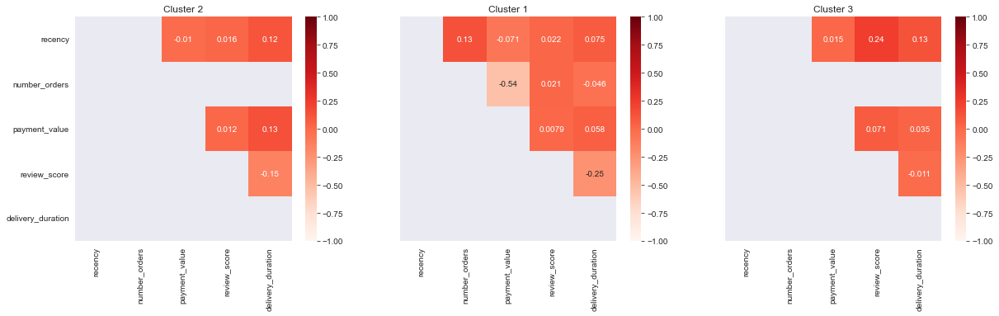

In [30]:
ch_cluster_details(['recency',
                    'number_orders',
                    'payment_value',
                    'review_score',
                    'delivery_duration'], 3)

In [31]:
model = AgglomerativeClustering(n_clusters=3, affinity='euclidean', linkage='ward')
model.fit(X_scaled_sample[rfm_cols])
labels_ch = model.labels_

silhouette_score(X_scaled_sample[rfm_cols], labels_ch)

0.3834526037048878

- D'un point de vue métier, le nombre de cluster (5) nous donne un score de silhouette moins bon que le KMeans. D'un point de vue métier, 3 clusters semblent être plus pertinent (et nous retourne un meilleur score de silhouette)

## 6/ DBSCAN

In [23]:
customer_sample = random.sample(data['customer_unique_id'].tolist(), 10000)
data_sample = data[data['customer_unique_id'].isin(customer_sample)].copy()

X_sample = data_sample.copy()
X_sample = X_sample[cols_to_use]

# Arrangement des certaines variables
X_sample['review_score'].fillna(np.round(X_sample['review_score'].mean(), 0), inplace=True)

# Standardisation du jeu de données
scaler = StandardScaler()
X_scaled_sample = scaler.fit_transform(X_sample)

X_scaled_sample = pd.DataFrame(X_scaled_sample, columns=cols_to_use)

In [24]:
X_db_std = X_scaled.copy()

dbscan = DBSCAN(eps=1, min_samples=10)
dbscan.fit(X_scaled_sample[['recency',
                            'number_orders',
                            'payment_value']])
labels = dbscan.labels_

X_scaled_sample['Cluster'] = labels

In [35]:
X_scaled_sample['Cluster'] = X_scaled_sample['Cluster'].astype(str)

fig = px.scatter_3d(X_scaled_sample, x=X_scaled_sample['recency'], y=X_scaled_sample['number_orders'],
                    z=X_scaled_sample['payment_value'],
                    color='Cluster')
fig.update_traces(marker_size=3)
fig.show()

- Nous pouvons voir que DBSCAN a tendance a classé les "bons" clients comme des outliers et donc dans aucun cluster. Le DBSCAN n'est pas adapté ici car ce modèle fonctionne sur la densité, hors les bons clients (paiement élevé et/ou nombre de commandes élevé) ne sont pas denses